# Mar 5th, 2022 (debug net; spearman > pearson)

**Motivation**: Chagned a few things in Network.  Foud out about problems with Pearson.  Good plotting functions for all degree centralities on cortex. <br>

In [1]:
# HIDE CODE


import os
import sys
import nibabel as nib
import networkx as nx
from time import time
from pprint import pprint
from copy import deepcopy as dc
from os.path import join as pjoin
from numpy.ma import masked_where as mwh
from scipy.ndimage import gaussian_filter
from IPython.display import display, IFrame, HTML
from matplotlib.colors import rgb2hex, to_rgb
import matplotlib.pyplot as plt
import seaborn as sns

# set style & no interpolalation
import matplotlib
matplotlib.rcParams['image.interpolation'] = 'none'
sns.set_style('whitegrid')
%matplotlib inline

# tmp & extras dir
git_dir = pjoin(os.environ['HOME'], 'Dropbox/git')
tmp_dir = pjoin(git_dir, 'jb-Ca-fMRI/tmp')
extras_dir = pjoin(git_dir, 'jb-Ca-fMRI/_extras')
lfr_dir = pjoin(os.environ['HOME'], 'Documents/workspaces/lfr/binary_overlapping')


# GitHub
sys.path.insert(0, pjoin(git_dir, '_Ca-fMRI'))
from register.atlas import make_tree_graph
from register.parcellation import Parcellation
from analysis.hierarchical import Hierarchical
from analysis.fourier import *
from analysis.bootstrap import *
from analysis.svinet import *
from analysis.group import *
from analysis.lfr import *
from utils.render import *
from utils.plotting import *
from model.mouse import Mice
from model.configuration import Config

# warnings
import warnings
warnings.filterwarnings('ignore', category=DeprecationWarning)

## Debug network

In [3]:
mice = Mice(256)
mice.setup_func_data('rest')

In [9]:
key = 'sub-SLC01_ses-1_run-3'
net = Network(mice, key, mode='bold-lite').load_network(full=True)

<matplotlib.image.AxesImage object at 0x7f8533409670>

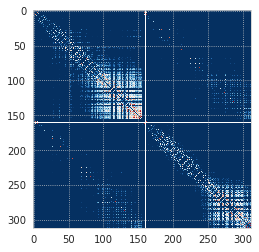

In [13]:
plt.imshow(net.adjacencies[10], cmap='RdBu_r', vmin=net.thresholds[10])

In [14]:
net.disconnected

{
    40: array([], dtype=int64),
    39: array([], dtype=int64),
    38: array([], dtype=int64),
    37: array([], dtype=int64),
    36: array([], dtype=int64),
    35: array([], dtype=int64),
    34: array([], dtype=int64),
    33: array([], dtype=int64),
    32: array([], dtype=int64),
    31: array([], dtype=int64),
    30: array([], dtype=int64),
    29: array([], dtype=int64),
    28: array([], dtype=int64),
    27: array([], dtype=int64),
    26: array([], dtype=int64),
    25: array([], dtype=int64),
    24: array([], dtype=int64),
    23: array([], dtype=int64),
    22: array([], dtype=int64),
    21: array([], dtype=int64),
    20: array([], dtype=int64),
    19: array([], dtype=int64),
    18: array([], dtype=int64),
    17: array([], dtype=int64),
    16: array([], dtype=int64),
    15: array([], dtype=int64),
    14: array([], dtype=int64),
    13: array([], dtype=int64),
    12: array([], dtype=int64),
    11: array([], dtype=int64),
    10: array([], dtype=int64),
    9: array([270]),
    8: array([168, 270]),
    7: array([168, 270]),
    6: array([ 59, 156, 168, 270]),
    5: array([ 14,  18,  19,  22,  59, 156, 168, 270]),
    4: array([ 12,  14,  18,  19,  22,  26,  38,  50,  59, 156, 157, 168, 245,
       257, 270, 281]),
    3: array([  9,  12,  14,  17,  18,  19,  22,  25,  26,  38,  50,  59,  73,
        77, 156, 157, 168, 184, 233, 245, 257, 270, 281]),
    2: array([  9,  12,  14,  17,  18,  19,  20,  22,  25,  26,  28,  30,  38,
        40,  45,  47,  48,  50,  51,  58,  59,  73,  77,  86, 156, 157,
       166, 168, 169, 184, 209, 218, 219, 229, 233, 235, 242, 245, 257,
       270, 281]),
    1: array([  9,  10,  11,  12,  14,  15,  16,  17,  18,  19,  20,  22,  25,
        26,  28,  29,  30,  34,  35,  36,  38,  40,  43,  44,  45,  47,
        48,  49,  50,  51,  52,  58,  59,  61,  62,  64,  68,  72,  73,
        77,  84,  86, 100, 137, 156, 157, 158, 160, 164, 165, 166, 168,
       169, 171, 172, 175, 176, 178, 179, 180, 184, 186, 187, 188, 189,
       193, 197, 203, 206, 207, 209, 216, 218, 219, 227, 228, 229, 231,
       233, 235, 240, 242, 243, 245, 248, 257, 270, 281])
}

In [16]:
bad_time = np.isnan(net.data).sum(0) == len(net.data)
good_nodes = np.isnan(net.data).sum(1) == bad_time.sum()

In [19]:
bad_time.sum(), good_nodes.sum()

(85, 310)

In [26]:
np.array_equal(~good_nodes, np.isnan(net.adj).sum(0) == len(net.adj))

True

In [28]:
np.where(~good_nodes)[0]

array([161, 293])

In [31]:
net.adj[[161, 293]]

array([[nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan],
       [nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan]])

In [4]:
key = 'sub-SLC01_ses-1_run-3'
net = Network(mice, key, mode='ca2')

In [5]:
net.load_network()

<analysis.network.Network object at 0x7f39781a24c0>

<matplotlib.image.AxesImage object at 0x7f3656c43c40>

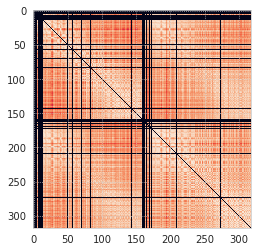

In [6]:
plt.imshow(net.adj)

In [7]:
nonzero = np.abs(net.adj).mean(0) > 0

In [8]:
nonzero

array([False, False, False, False, False, False,  True, False, False,
       False, False,  True, False, False,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True, False,  True,  True,  True,
        True,  True,  True, False,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True, False,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True, False,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True, False,  True,  True,  True,  True, False,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True, False, False, False,
       False, False,  True, False, False,  True,  True, False,  True,
        True, False,  True,  True,  True,  True,  True,  True, False,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True, False,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True, False,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True, False,  True,  True,  True,  True,  True,  True,
       False,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True])

In [9]:
net.fit_network(force=True)

[PROGRESS] fit: initiated

[PROGRESS] graphs: done

[PROGRESS] fit: done!

<analysis.network.Network object at 0x7f39781a24c0>

In [10]:
net.disconnected

{
    40: array([ 11, 170]),
    39: array([ 11, 170]),
    38: array([ 11, 170]),
    37: array([ 11, 170, 194]),
    36: array([ 11, 170, 194]),
    35: array([ 11, 170, 194]),
    34: array([ 11, 170, 194]),
    33: array([ 11, 170, 194]),
    32: array([ 11, 167, 170, 194]),
    31: array([ 11, 167, 170, 194]),
    30: array([ 11, 167, 170, 194]),
    29: array([ 11, 167, 170, 194]),
    28: array([ 11, 167, 168, 170, 194]),
    27: array([ 11, 167, 168, 170, 194]),
    26: array([ 11, 167, 168, 170, 194]),
    25: array([ 11, 167, 168, 170, 194]),
    24: array([ 11, 167, 168, 170, 194]),
    23: array([ 11, 167, 168, 170, 194]),
    22: array([ 11, 167, 168, 170, 194]),
    21: array([ 11, 167, 168, 170, 194]),
    20: array([ 11, 167, 168, 170, 194]),
    19: array([ 11, 167, 168, 170, 194]),
    18: array([ 11, 167, 168, 170, 194]),
    17: array([ 11, 167, 168, 170, 194]),
    16: array([ 11, 167, 168, 170, 194]),
    15: array([ 11, 167, 168, 170, 194]),
    14: array([ 11, 167, 168, 170, 194]),
    13: array([ 11, 167, 168, 170, 194]),
    12: array([ 11, 167, 168, 170, 194]),
    11: array([ 11, 167, 168, 170, 194]),
    10: array([ 11, 167, 168, 170, 171, 194]),
    9: array([ 11, 167, 168, 170, 171, 194]),
    8: array([ 11, 167, 168, 170, 171, 194]),
    7: array([ 11,  90, 167, 168, 170, 171, 194, 285]),
    6: array([ 11,  90, 167, 168, 170, 171, 194, 285]),
    5: array([ 11,  90, 164, 167, 168, 170, 171, 194, 285]),
    4: array([ 11,  90, 164, 167, 168, 170, 171, 194, 261, 285]),
    3: array([  6,  11,  90, 114, 131, 164, 167, 168, 170, 171, 194, 261, 285]),
    2: array([  6,  11,  17,  29,  35,  44,  49,  77,  90,  92, 105, 113, 114,
       119, 131, 164, 167, 168, 170, 171, 174, 176, 194, 208, 261, 285]),
    1: array([  6,  11,  15,  17,  19,  27,  28,  29,  35,  36,  39,  44,  49,
        56,  61,  77,  87,  90,  92, 105, 113, 114, 119, 127, 131, 149,
       155, 158, 164, 167, 168, 170, 171, 173, 174, 176, 178, 182, 185,
       186, 188, 189, 194, 208, 227, 233, 236, 237, 240, 251, 261, 264,
       274, 285, 304])
}

[<matplotlib.lines.Line2D object at 0x7f364ff8d550>]

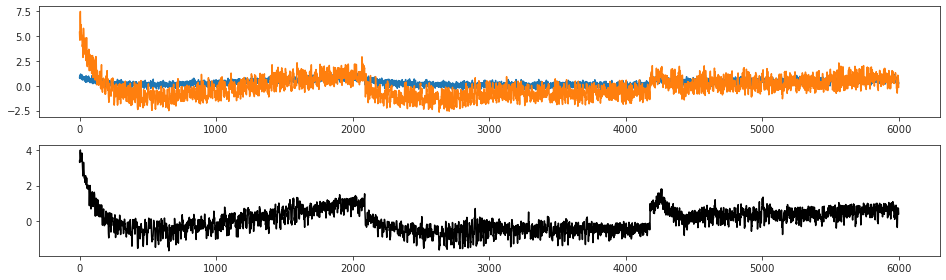

In [11]:
fig, axes = create_figure(2, 1, figsize=(13, 4))
axes[0].plot(net.data[11])
axes[0].plot(net.data[56])

axes[1].plot(bn.nanmean(net.data, 0), 'k')

In [12]:
mu = bn.nanmean(net.data, 1)
sd = bn.nanstd(net.data, 1)
snr = mu / sd

In [13]:
snr[11], snr[62]

(1.1216439617844638, 0.23809631906490772)

[<matplotlib.lines.Line2D object at 0x7f364ff100d0>]

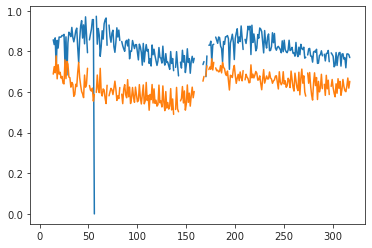

In [14]:
plt.plot(net.adj[56])
plt.plot(net.adj[11])

In [15]:
np.where(net.adj[56] == 0)

(array([56]),)

<matplotlib.image.AxesImage object at 0x7f364fedd880>

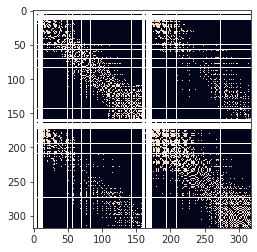

In [16]:
plt.imshow(net.adjacencies[10])

<matplotlib.image.AxesImage object at 0x7f364fe49bb0>

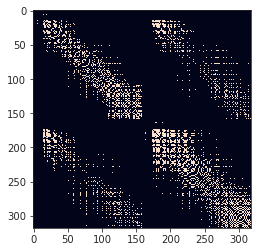

In [17]:
g = net.graphs[10]
plt.imshow(nx.adjacency_matrix(g).toarray())

In [18]:
np.array_equal(
    np.abs(nx.adjacency_matrix(net.graphs[10]).toarray()).mean(0) == 0,
    np.isnan(net.adjacencies[10]).sum(0) == len(net.adjacencies[10])
)

True

In [20]:
aaa = np.abs(nx.adjacency_matrix(net.graphs[10]).toarray()).mean(0) == 0
bbb = np.isnan(net.adjacencies[10]).sum(0) == len(net.adjacencies[10])
np.where(aaa.astype(int) != bbb.astype(int))[0]

array([], dtype=int64)

In [21]:
net.disconnected[10]

array([ 11, 167, 168, 170, 171, 194])

In [24]:
rho = rho = [p / 100 for p in net.percentiles]
calculate_threshold(net.adj, rho, True)

threshold = 0.863   /   density:  requested = 0.40000, result = 0.40000;

threshold = 0.865   /   density:  requested = 0.39000, result = 0.39001;

threshold = 0.867   /   density:  requested = 0.38000, result = 0.38000;

threshold = 0.869   /   density:  requested = 0.37000, result = 0.36999;

threshold = 0.871   /   density:  requested = 0.36000, result = 0.36000;

threshold = 0.873   /   density:  requested = 0.35000, result = 0.34999;

threshold = 0.875   /   density:  requested = 0.34000, result = 0.34001;

threshold = 0.877   /   density:  requested = 0.33000, result = 0.33000;

threshold = 0.879   /   density:  requested = 0.32000, result = 0.32001;

threshold = 0.880   /   density:  requested = 0.31000, result = 0.31000;

threshold = 0.882   /   density:  requested = 0.30000, result = 0.30001;

threshold = 0.884   /   density:  requested = 0.29000, result = 0.29000;

threshold = 0.886   /   density:  requested = 0.28000, result = 0.28001;

threshold = 0.888   /   density:  requested = 0.27000, result = 0.27000;

threshold = 0.890   /   density:  requested = 0.26000, result = 0.26002;

threshold = 0.892   /   density:  requested = 0.25000, result = 0.25001;

threshold = 0.894   /   density:  requested = 0.24000, result = 0.24000;

threshold = 0.897   /   density:  requested = 0.23000, result = 0.23001;

threshold = 0.899   /   density:  requested = 0.22000, result = 0.22000;

threshold = 0.901   /   density:  requested = 0.21000, result = 0.21001;

threshold = 0.903   /   density:  requested = 0.20000, result = 0.20000;

threshold = 0.905   /   density:  requested = 0.19000, result = 0.19001;

threshold = 0.908   /   density:  requested = 0.18000, result = 0.18000;

threshold = 0.910   /   density:  requested = 0.17000, result = 0.17002;

threshold = 0.913   /   density:  requested = 0.16000, result = 0.16000;

threshold = 0.915   /   density:  requested = 0.15000, result = 0.15002;

threshold = 0.917   /   density:  requested = 0.14000, result = 0.14001;

threshold = 0.920   /   density:  requested = 0.13000, result = 0.13002;

threshold = 0.923   /   density:  requested = 0.12000, result = 0.12001;

threshold = 0.925   /   density:  requested = 0.11000, result = 0.11000;

threshold = 0.928   /   density:  requested = 0.10000, result = 0.10001;

threshold = 0.932   /   density:  requested = 0.09000, result = 0.09000;

threshold = 0.935   /   density:  requested = 0.08000, result = 0.08001;

threshold = 0.938   /   density:  requested = 0.07000, result = 0.07000;

threshold = 0.942   /   density:  requested = 0.06000, result = 0.06002;

threshold = 0.947   /   density:  requested = 0.05000, result = 0.05001;

threshold = 0.952   /   density:  requested = 0.04000, result = 0.04002;

threshold = 0.958   /   density:  requested = 0.03000, result = 0.03001;

threshold = 0.965   /   density:  requested = 0.02000, result = 0.02002;

threshold = 0.973   /   density:  requested = 0.01000, result = 0.01001;

array([0.86337883, 0.86526693, 0.86715971, 0.8692822 , 0.87120063,
       0.87319048, 0.87508713, 0.87683929, 0.87861429, 0.8804664 ,
       0.8823337 , 0.88426724, 0.88623673, 0.88826781, 0.89027726,
       0.89232213, 0.89436278, 0.89672709, 0.89875343, 0.9009584 ,
       0.90301893, 0.9053267 , 0.9076232 , 0.91011479, 0.91253686,
       0.91490366, 0.91724847, 0.91970184, 0.9225739 , 0.92536384,
       0.92832192, 0.93160881, 0.93478129, 0.93823355, 0.94228564,
       0.94663976, 0.9519264 , 0.95806467, 0.9648548 , 0.97336903])

## Fig dir

In [3]:
fig_dir = pjoin(tmp_dir, 'fig_25th')
os.makedirs(fig_dir, exist_ok=True)

## Prepare

In [4]:
mice = Mice((128, 0, 100))
mice.setup_func_data('rest')

mako = sns.color_palette('mako', as_cmap=True)
rocket = sns.color_palette('rocket', as_cmap=True)
pal = {'ca2': mako(0.6), 'bold-lite': rocket(0.6)}

num_k, perc = 5, 10
props_base = {
    'perc': f'p{perc}-sample',
    'num_k': num_k,
    'mice': mice,
    'task': 'rest',
    'metric': 'pearson',
    'match_using': 'gam',
    'match_metric': 'euclidean',
    'graph_type': 'real',
    'verbose': False,
}
props_ca = {'mode': 'ca2', **props_base}
props_bold = {'mode': 'bold-lite', **props_base}

In [5]:
gr_ca = Group(**props_ca).fit_group()
gr_bold = Group(**props_bold).fit_group()

sim = dist2sim(sp_dist.cdist(
    XA=gr_bold.grp_pi,
    XB=gr_ca.grp_pi,
    metric='cosine',
))
mapping = find_best_match(sim)
ids = list(mapping.values())

gr_bold.pi = gr_bold.grp_pi
gr_ca.pi = gr_ca.grp_pi[ids]

proj_bold = gr_bold.project_vec()
proj_ca = gr_ca.project_vec()

ids

[0, 1, 2, 3, 4]

In [115]:
from numpy.ma import masked_where as mwh
from scipy.ndimage import gaussian_filter

### Group pi

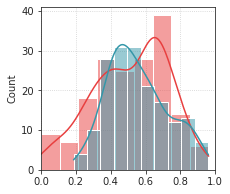

In [26]:
h_bold = sp_stats.entropy(gr_bold.grp_pi_prune) / np.log(gr_bold.num_k)
h_ca = sp_stats.entropy(gr_ca.grp_pi_prune) / np.log(gr_ca.num_k)

fig, ax = create_figure(figsize=(3.3, 2.8))
sns.histplot(h_bold, color=pal['bold-lite'], kde=True)
sns.histplot(h_ca, color=pal['ca2'], kde=True)
ax.set_xlim(0, 1)
ax.grid()

In [27]:
h_thres = -np.inf
hpb = gr_bold.project_vec(h_bold, thres=h_thres, add_disjoint=False)
hpc = gr_ca.project_vec(h_ca, thres=h_thres, add_disjoint=False)

hr_bold = sp_stats.rankdata(h_bold)
hr_ca = sp_stats.rankdata(h_ca)

hrpb = gr_bold.project_vec(hr_bold, thres=h_thres, add_disjoint=False)
hrpc = gr_ca.project_vec(hr_ca, thres=h_thres, add_disjoint=False)

trb = gr_bold.trim2d(hrpb)
trc = gr_bold.trim2d(hrpc)

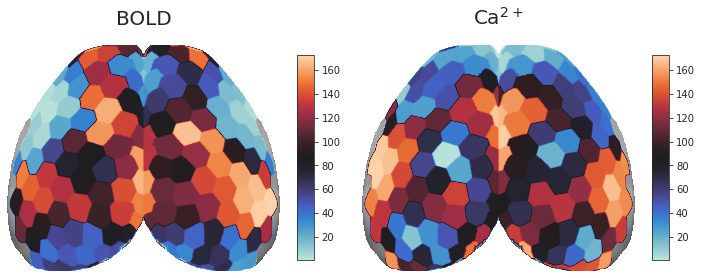

In [29]:
fig, axes = create_figure(1, 2, (10, 4))

x2p = np.ma.masked_where(trb['top'] == 0, trb['top'])
axes[0].imshow(x2p, cmap='Greys_r')

x2p = gaussian_filter(trb['proj-top'][0], sigma=1)
x2p = np.ma.masked_where(x2p == 0, x2p)
im = axes[0].imshow(x2p, cmap='icefire', interpolation='antialiased')
plt.colorbar(im, ax=axes[0], aspect=12, shrink=0.8)

x2p = np.ma.masked_where(trc['top'] == 0, trc['top'])
axes[1].imshow(x2p, cmap='Greys_r')

x2p = gaussian_filter(trc['proj-top'][0], sigma=1)
x2p = np.ma.masked_where(x2p == 0, x2p)
im = axes[1].imshow(x2p, cmap='icefire', interpolation='antialiased')
plt.colorbar(im, ax=axes[1], aspect=12, shrink=0.8)

axes[0].set_title('BOLD', fontsize=20, y=1.06)
axes[1].set_title(r'Ca$^{2+}$', fontsize=20, y=1.06)
remove_ticks(axes)

name = 'entropy'
figname = f"{name}.pdf"
# fig.savefig(pjoin(fig_dir, figname), bbox_inches='tight')
for dpi in [100, 300, 600]:
    figname = f"{name}_dpi{dpi}.png"
    # fig.savefig(pjoin(fig_dir, figname), bbox_inches='tight', dpi=dpi)

plt.show()

### Each run separately

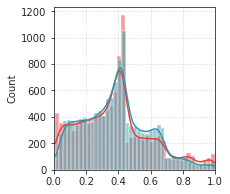

In [49]:
h_bold = sp_stats.entropy(gr_bold.run_pi_prune, axis=-2) / np.log(gr_bold.num_k)
h_ca = sp_stats.entropy(gr_ca.run_pi_prune, axis=-2) / np.log(gr_ca.num_k)

fig, ax = create_figure(figsize=(3.3, 2.8))
sns.histplot(h_bold[h_bold.nonzero()], color=pal['bold-lite'], kde=True)
sns.histplot(h_ca[h_ca.nonzero()], color=pal['ca2'], kde=True)
ax.set_xlim(0, 1)
ax.grid()

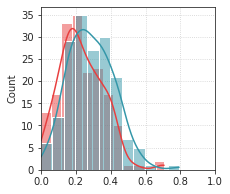

In [50]:
h_bold = bn.nanmean(bn.nanmean(bn.nanmean(h_bold, 2), 1), 0)
h_ca = bn.nanmean(bn.nanmean(bn.nanmean(h_ca, 2), 1), 0)

fig, ax = create_figure(figsize=(3.3, 2.8))
sns.histplot(h_bold, color=pal['bold-lite'], kde=True)
sns.histplot(h_ca, color=pal['ca2'], kde=True)
ax.set_xlim(0, 1)
ax.grid()

In [51]:
h_thres = -np.inf
hpb = gr_bold.project_vec(h_bold, thres=h_thres, add_disjoint=False)
hpc = gr_ca.project_vec(h_ca, thres=h_thres, add_disjoint=False)

hr_bold = sp_stats.rankdata(h_bold)
hr_ca = sp_stats.rankdata(h_ca)

hrpb = gr_bold.project_vec(hr_bold, thres=h_thres, add_disjoint=False)
hrpc = gr_ca.project_vec(hr_ca, thres=h_thres, add_disjoint=False)

trb = gr_bold.trim2d(hrpb)
trc = gr_bold.trim2d(hrpc)

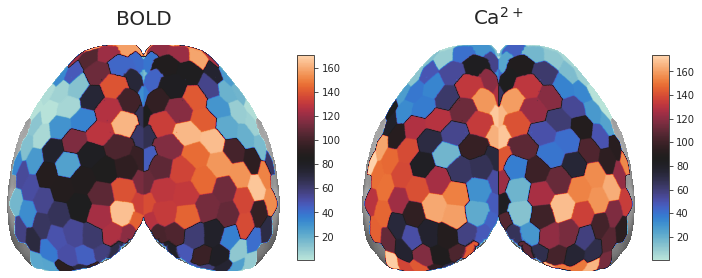

In [52]:
fig, axes = create_figure(1, 2, (10, 4))

x2p = np.ma.masked_where(trb['top'] == 0, trb['top'])
axes[0].imshow(x2p, cmap='Greys_r')

x2p = gaussian_filter(trb['proj-top'][0], sigma=1)
x2p = np.ma.masked_where(x2p == 0, x2p)
im = axes[0].imshow(x2p, cmap='icefire', interpolation='antialiased')
plt.colorbar(im, ax=axes[0], aspect=12, shrink=0.8)

x2p = np.ma.masked_where(trc['top'] == 0, trc['top'])
axes[1].imshow(x2p, cmap='Greys_r')

x2p = gaussian_filter(trc['proj-top'][0], sigma=1)
x2p = np.ma.masked_where(x2p == 0, x2p)
im = axes[1].imshow(x2p, cmap='icefire', interpolation='antialiased')
plt.colorbar(im, ax=axes[1], aspect=12, shrink=0.8)

axes[0].set_title('BOLD', fontsize=20, y=1.06)
axes[1].set_title(r'Ca$^{2+}$', fontsize=20, y=1.06)
remove_ticks(axes)

name = 'entropy'
figname = f"{name}.pdf"
# fig.savefig(pjoin(fig_dir, figname), bbox_inches='tight')
for dpi in [100, 300, 600]:
    figname = f"{name}_dpi{dpi}.png"
    # fig.savefig(pjoin(fig_dir, figname), bbox_inches='tight', dpi=dpi)

plt.show()

### Animals as units of variability

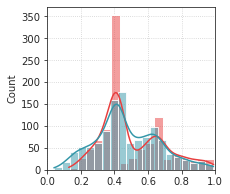

In [64]:
h_bold = sp_stats.entropy(gr_bold.anim_pi_prune, axis=-2) / np.log(gr_bold.num_k)
h_ca = sp_stats.entropy(gr_ca.anim_pi_prune, axis=-2) / np.log(gr_ca.num_k)

fig, ax = create_figure(figsize=(3.3, 2.8))
sns.histplot(h_bold[h_bold.nonzero()], color=pal['bold-lite'], kde=True)
sns.histplot(h_ca[h_ca.nonzero()], color=pal['ca2'], kde=True)
ax.set_xlim(0, 1)
ax.grid()

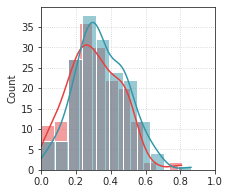

In [65]:
h_bold = bn.nanmean(h_bold, 0)
h_ca = bn.nanmean(h_ca, 0)

fig, ax = create_figure(figsize=(3.3, 2.8))
sns.histplot(h_bold, color=pal['bold-lite'], kde=True)
sns.histplot(h_ca, color=pal['ca2'], kde=True)
ax.set_xlim(0, 1)
ax.grid()

In [66]:
h_thres = -np.inf
hpb = gr_bold.project_vec(h_bold, thres=h_thres, add_disjoint=False)
hpc = gr_ca.project_vec(h_ca, thres=h_thres, add_disjoint=False)

hr_bold = sp_stats.rankdata(h_bold)
hr_ca = sp_stats.rankdata(h_ca)

hrpb = gr_bold.project_vec(hr_bold, thres=h_thres, add_disjoint=False)
hrpc = gr_ca.project_vec(hr_ca, thres=h_thres, add_disjoint=False)

trb = gr_bold.trim2d(hrpb)
trc = gr_bold.trim2d(hrpc)

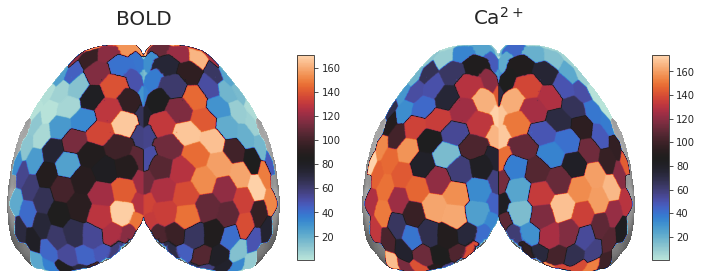

In [67]:
fig, axes = create_figure(1, 2, (10, 4))

x2p = np.ma.masked_where(trb['top'] == 0, trb['top'])
axes[0].imshow(x2p, cmap='Greys_r')

x2p = gaussian_filter(trb['proj-top'][0], sigma=1)
x2p = np.ma.masked_where(x2p == 0, x2p)
im = axes[0].imshow(x2p, cmap='icefire', interpolation='antialiased')
plt.colorbar(im, ax=axes[0], aspect=12, shrink=0.8)

x2p = np.ma.masked_where(trc['top'] == 0, trc['top'])
axes[1].imshow(x2p, cmap='Greys_r')

x2p = gaussian_filter(trc['proj-top'][0], sigma=1)
x2p = np.ma.masked_where(x2p == 0, x2p)
im = axes[1].imshow(x2p, cmap='icefire', interpolation='antialiased')
plt.colorbar(im, ax=axes[1], aspect=12, shrink=0.8)

axes[0].set_title('BOLD', fontsize=20, y=1.06)
axes[1].set_title(r'Ca$^{2+}$', fontsize=20, y=1.06)
remove_ticks(axes)

name = 'entropy'
figname = f"{name}.pdf"
# fig.savefig(pjoin(fig_dir, figname), bbox_inches='tight')
for dpi in [100, 300, 600]:
    figname = f"{name}_dpi{dpi}.png"
    # fig.savefig(pjoin(fig_dir, figname), bbox_inches='tight', dpi=dpi)

plt.show()

### Group pi (not pruned)

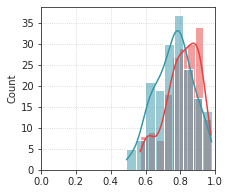

In [71]:
h_bold = sp_stats.entropy(gr_bold.grp_pi) / np.log(gr_bold.num_k)
h_ca = sp_stats.entropy(gr_ca.grp_pi) / np.log(gr_ca.num_k)

fig, ax = create_figure(figsize=(3.3, 2.8))
sns.histplot(h_bold, color=pal['bold-lite'], kde=True)
sns.histplot(h_ca, color=pal['ca2'], kde=True)
ax.set_xlim(0, 1)
ax.grid()

In [72]:
h_thres = -np.inf
hpb = gr_bold.project_vec(h_bold, thres=h_thres, add_disjoint=False)
hpc = gr_ca.project_vec(h_ca, thres=h_thres, add_disjoint=False)

hr_bold = sp_stats.rankdata(h_bold)
hr_ca = sp_stats.rankdata(h_ca)

hrpb = gr_bold.project_vec(hr_bold, thres=h_thres, add_disjoint=False)
hrpc = gr_ca.project_vec(hr_ca, thres=h_thres, add_disjoint=False)

trb = gr_bold.trim2d(hrpb)
trc = gr_bold.trim2d(hrpc)

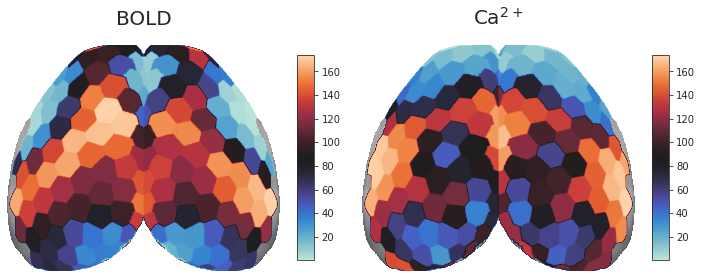

In [73]:
fig, axes = create_figure(1, 2, (10, 4))

x2p = np.ma.masked_where(trb['top'] == 0, trb['top'])
axes[0].imshow(x2p, cmap='Greys_r')

x2p = gaussian_filter(trb['proj-top'][0], sigma=1)
x2p = np.ma.masked_where(x2p == 0, x2p)
im = axes[0].imshow(x2p, cmap='icefire', interpolation='antialiased')
plt.colorbar(im, ax=axes[0], aspect=12, shrink=0.8)

x2p = np.ma.masked_where(trc['top'] == 0, trc['top'])
axes[1].imshow(x2p, cmap='Greys_r')

x2p = gaussian_filter(trc['proj-top'][0], sigma=1)
x2p = np.ma.masked_where(x2p == 0, x2p)
im = axes[1].imshow(x2p, cmap='icefire', interpolation='antialiased')
plt.colorbar(im, ax=axes[1], aspect=12, shrink=0.8)

axes[0].set_title('BOLD', fontsize=20, y=1.06)
axes[1].set_title(r'Ca$^{2+}$', fontsize=20, y=1.06)
remove_ticks(axes)

name = 'entropy'
figname = f"{name}.pdf"
# fig.savefig(pjoin(fig_dir, figname), bbox_inches='tight')
for dpi in [100, 300, 600]:
    figname = f"{name}_dpi{dpi}.png"
    # fig.savefig(pjoin(fig_dir, figname), bbox_inches='tight', dpi=dpi)

plt.show()

## Cartography

In [74]:
affil, affil_included = gr_bold.node_affiliations()

In [75]:
df_carto_ca = gr_ca.mk_cartography_df(affil=affil_included)
df_carto_bold = gr_bold.mk_cartography_df(affil=affil_included)
df_carto_bold = df_carto_bold.loc[~df_carto_bold['affil'].isin(['Auditory', 'Lateral'])]
df_carto_ca = df_carto_ca.loc[~df_carto_ca['affil'].isin(['Auditory', 'Lateral'])]

df_carto = pd.concat([df_carto_bold, df_carto_ca])

In [76]:
xlim = (-0.03, 0.7)
ylim = (2, 35)

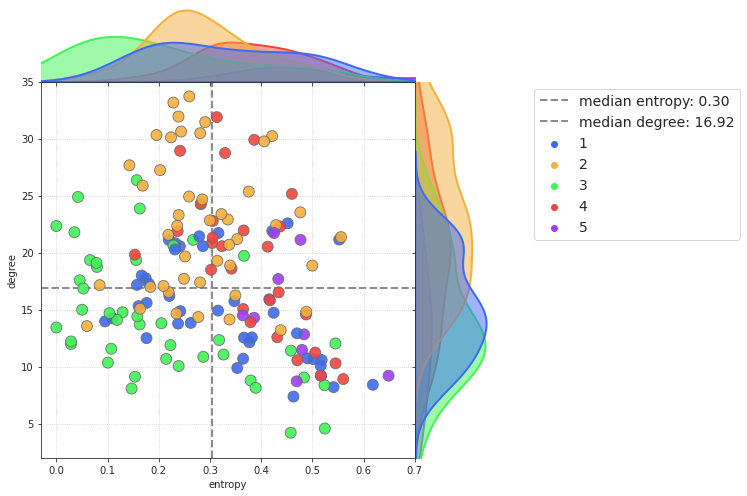

In [77]:
jg = plot_cartography(
    df=df_carto_bold,
    palette=gr_bold.colors,
    xlim=xlim,
    ylim=ylim,
    grid=True,
)

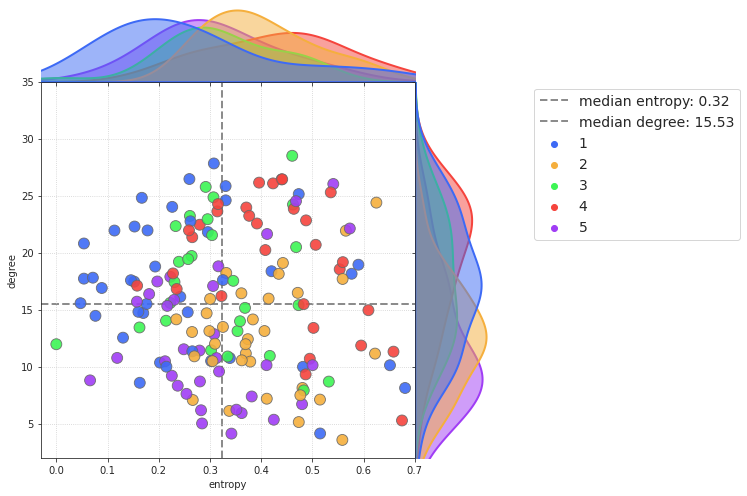

In [78]:
jg = plot_cartography(
    df=df_carto_ca,
    palette=gr_ca.colors,
    xlim=xlim,
    ylim=ylim,
    grid=True,
)

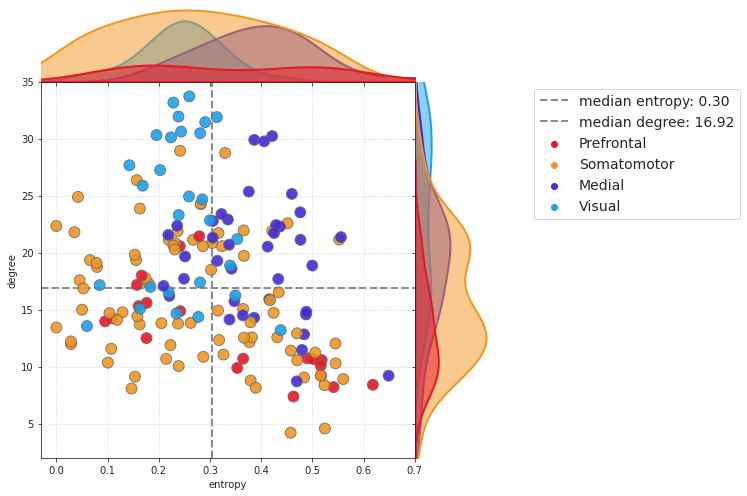

In [79]:
jg = plot_cartography(
    df=df_carto_bold,
    palette=affil['colors'],
    hue='affil',
    xlim=xlim,
    ylim=ylim,
    grid=True,
)

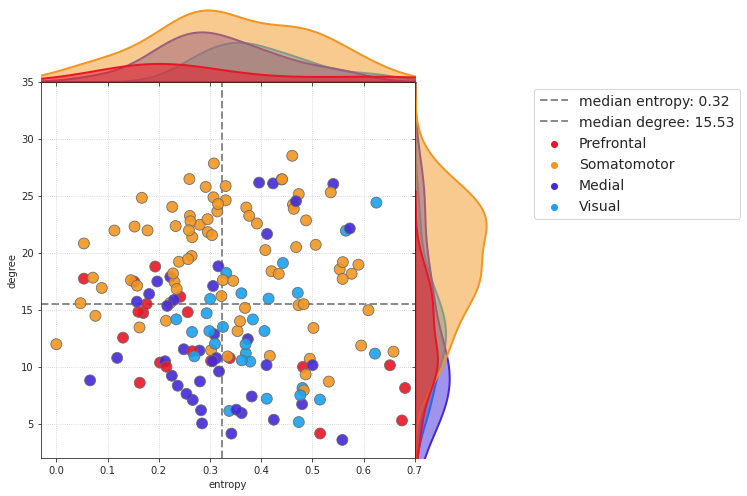

In [80]:

jg = plot_cartography(
    df=df_carto_ca,
    palette=affil['colors'],
    hue='affil',
    xlim=xlim,
    ylim=ylim,
    grid=True,
)

### What about different h?

In [25]:
h_bold = sp_stats.entropy(gr_bold.grp_pi_prune) / np.log(gr_bold.num_k)
h_ca = sp_stats.entropy(gr_ca.grp_pi_prune) / np.log(gr_ca.num_k)

### Weighted degrees

In [81]:
gr_bold.run_deg.shape

(10, 3, 4, 174)

In [84]:
dpb = gr_bold.project_vec(gr_bold.run_deg.reshape(-1, 174), add_disjoint=False)
dpc = gr_ca.project_vec(gr_ca.run_deg.reshape(-1, 174), add_disjoint=False)

In [85]:
trb = gr_bold.trim2d(dpb)
trc = gr_bold.trim2d(dpc)

In [86]:
list(trb)

['top', 'proj-top', 'flat', 'proj-flat']

In [87]:
trb['proj-top'].shape

(120, 857, 1034)

<AxesSubplot:ylabel='Count'>

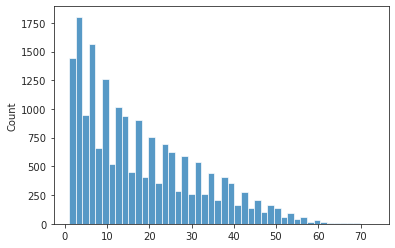

In [138]:
sns.histplot(gr_bold.run_deg[np.isfinite(gr_bold.run_deg)])

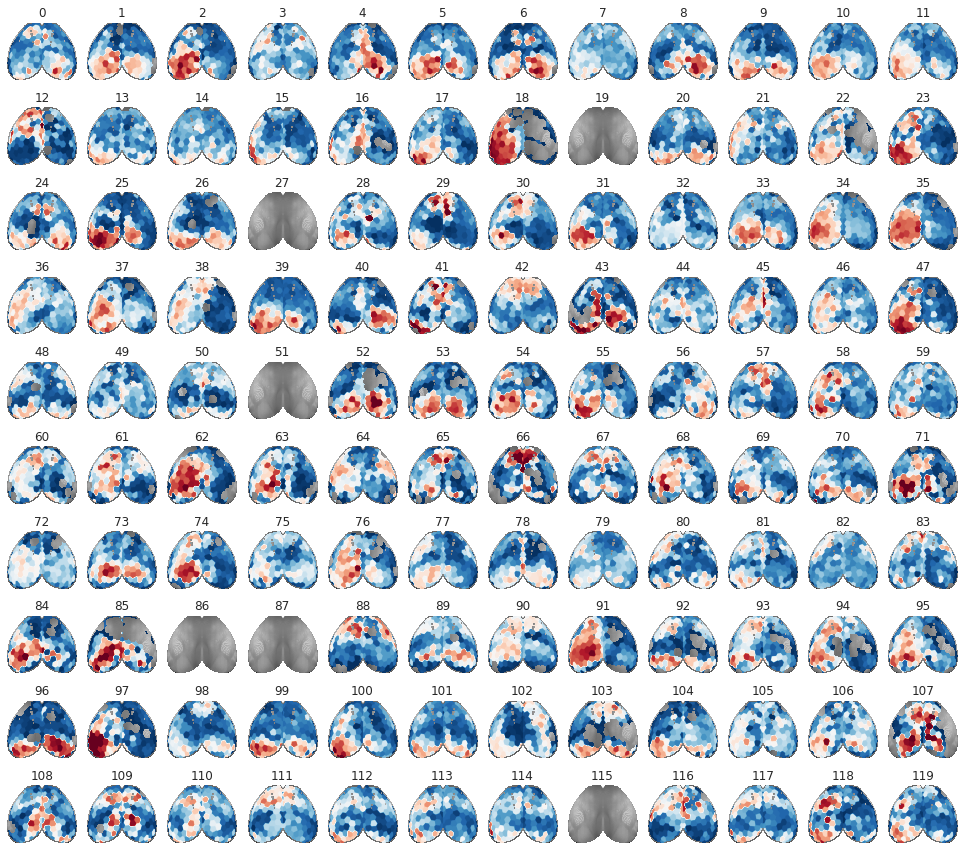

In [139]:
fig, axes = create_figure(10, 12, (13.5, 12))

for i, ax in enumerate(axes.flat):
    x2p = mwh(trb['top'] == 0, trb['top'])
    ax.imshow(x2p, cmap='Greys_r')
    x2p = mwh(trb['top'] == 0, trb['proj-top'][i])
    ax.imshow(x2p, cmap='RdBu_r', interpolation='antialiased', vmin=1, vmax=60)
    ax.set_title(i)

remove_ticks(axes)

In [126]:
x = gr_bold.run_deg.reshape(-1, 174)[85]

In [127]:
x

memmap([14.,  2.,  2., 11., 23.,  3.,  5.,  3.,  2.,  3., 18.,  6.,  1.,
        nan, nan, nan, 25.,  1.,  7., nan, nan,  1., nan,  1., 20.,  1.,
        nan, nan,  1., 20., 18.,  1., 28., 37., nan,  1.,  2., 40., 19.,
        15., 10.,  3., 34., 42., 38., 24., 49., 12., 12., 59., 53., 55.,
        48., 37., 29., 56., 57., 42., 34., 65., 64., 18., 54., 54., 51.,
        54.,  9., 46., 46., 69., 39., 37., 50., 53., 51., 17., 45.,  3.,
        28., 25., 48., 18.,  6.,  1.,  1., 12., 12.,  3.,  2.,  1., 11.,
        nan,  2.,  2.,  1., nan,  1.,  9., nan, nan, nan, nan, nan, 35.,
        nan, nan,  2., nan,  1., nan, nan, 17.,  1., nan, nan, nan, nan,
        nan,  1., 15., 16., nan,  1., nan, nan, nan, nan,  8., nan, 15.,
        17., 20., nan, 37., nan, nan, 44., 36.,  2., 27.,  6.,  4., 54.,
        36., nan, 11., 29., 28.,  9.,  4., 45., 36., 24., 41., 42., 55.,
         5., 17.,  4., 34., 45., 16.,  6., 17.,  4., 38.,  6., 19., 16.,
        16.,  8.,  3.,  3.,  1.])

<AxesSubplot:ylabel='Count'>

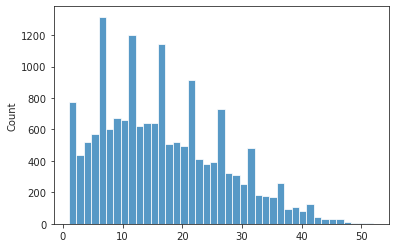

In [134]:
sns.histplot(gr_ca.run_deg[np.isfinite(gr_ca.run_deg)])

In [136]:
np.nanmin(gr_ca.run_deg), np.nanmax(gr_ca.run_deg)

(1.0, 52.0)

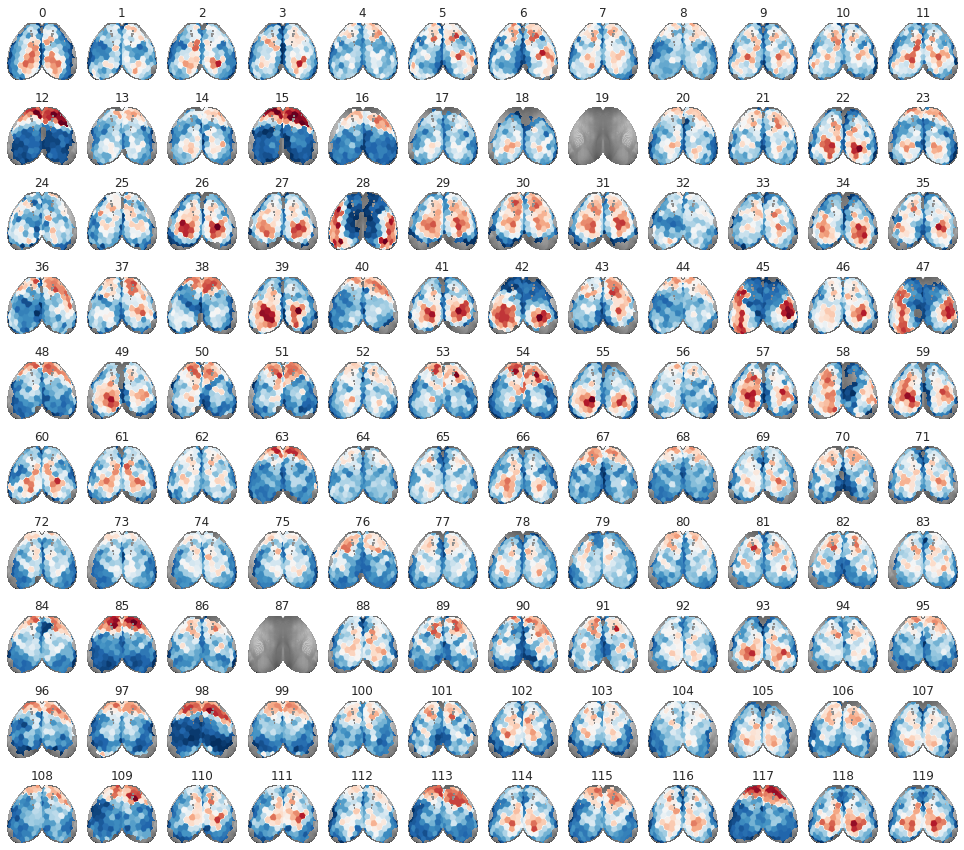

In [137]:
fig, axes = create_figure(10, 12, (13.5, 12))

for i, ax in enumerate(axes.flat):
    x2p = mwh(trc['top'] == 0, trc['top'])
    ax.imshow(x2p, cmap='Greys_r')
    x2p = mwh(trc['top'] == 0, trc['proj-top'][i])
    ax.imshow(x2p, cmap='RdBu_r', interpolation='antialiased', vmin=1, vmax=50)
    ax.set_title(i)

remove_ticks(axes)

In [4]:
mice = Mice(256)
mice.setup_func_data('all')

In [5]:
pearson, spearman = {}, {}
for key, f in tqdm(mice.ca.items()):
    if f.task is None:
        continue
    x = f[:]
    nn = len(x)
    badt = np.isnan(x).sum(0) == nn
    good = np.isnan(x).sum(1) == badt.sum()
    mask = good.reshape(-1, 1) @ good.reshape(1, -1)
    x = x[good][:, ~badt]

    a = np_nans((nn,) * 2)
    a[mask] = get_adj_mat(x, 'pearson')[0].flat
    pearson[f"{key}_task-{f.task}"] = a
    
    a = np_nans((nn,) * 2)
    a[mask] = get_adj_mat(x, 'spearman')[0].flat
    spearman[f"{key}_task-{f.task}"] = a

  0%|          | 0/252 [00:00<?, ?it/s]

In [6]:
pearson_adj_ca, spearman_adj_ca = [], []
for k, pr in pearson.items():
    pearson_adj_ca.append(np.expand_dims(pr, axis=0))
    spearman_adj_ca.append(np.expand_dims(spearman[k], axis=0))
pearson_adj_ca = np.concatenate(pearson_adj_ca)
spearman_adj_ca = np.concatenate(spearman_adj_ca)
pearson_adj_ca[pearson_adj_ca < 0.] = 0.
spearman_adj_ca[spearman_adj_ca < 0.] = 0.

deg_pearson_ca = np.nansum(pearson_adj_ca, -1)
deg_spearman_ca = np.nansum(spearman_adj_ca, -1)

pearson_adj_ca.shape, spearman_adj_ca.shape

((252, 318, 318), (252, 318, 318))

In [7]:
led_run_ids = []
rest_run_ids = []
valid_run_ids = []
for i, k in enumerate(pearson):
    task = k.split('_')[-1].split('-')[-1]
    key = '_'.join(k.split('_')[:-1])
    *_, run = mice.looper[key]
    if run != -1:
        valid_run_ids.append(i)
        if task == 'led':
            led_run_ids.append(i)
        else:
            rest_run_ids.append(i)
led_run_ids = np.array(led_run_ids)
rest_run_ids = np.array(rest_run_ids)
valid_run_ids = np.array(valid_run_ids)

len(led_run_ids), len(rest_run_ids), len(valid_run_ids)

(90, 118, 208)

<AxesSubplot:ylabel='Count'>

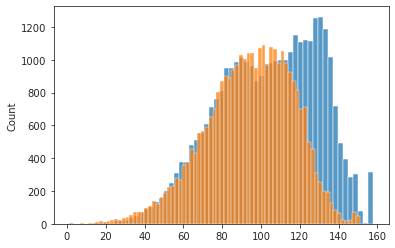

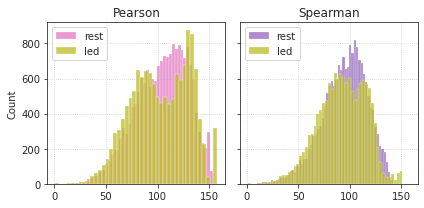

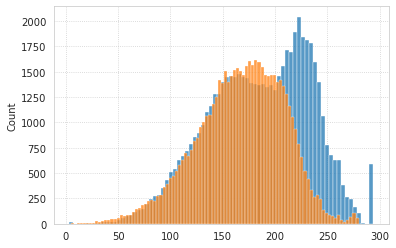

In [8]:
deg_pearson_ca = np.nansum(pearson_adj_ca, -1)
deg_spearman_ca = np.nansum(spearman_adj_ca, -1)

x = deg_pearson_ca[valid_run_ids].copy()
sns.histplot(x[x.nonzero()], color='C0')
x = deg_spearman_ca[valid_run_ids].copy()
sns.histplot(x[x.nonzero()], color='C1');

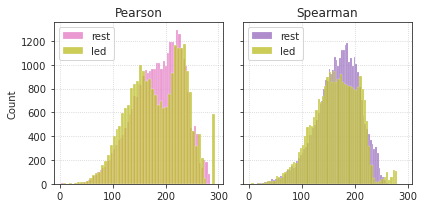

In [9]:
fig, axes = create_figure(1, 2, (6, 3), 'all', 'all')

x = deg_pearson_ca[rest_run_ids].copy()
sns.histplot(x[x.nonzero()], color='C6', label='rest', ax=axes[0])
x = deg_pearson_ca[led_run_ids].copy()
sns.histplot(x[x.nonzero()], color='C8', label='led', ax=axes[0])
axes[0].legend()
axes[0].set_title('Pearson')

x = deg_spearman_ca[rest_run_ids].copy()
sns.histplot(x[x.nonzero()], color='C4', label='rest', ax=axes[1])
x = deg_spearman_ca[led_run_ids].copy()
sns.histplot(x[x.nonzero()], color='C8', label='led', ax=axes[1])
axes[1].legend()
axes[1].set_title('Spearman')

add_grid(axes)

plt.show()

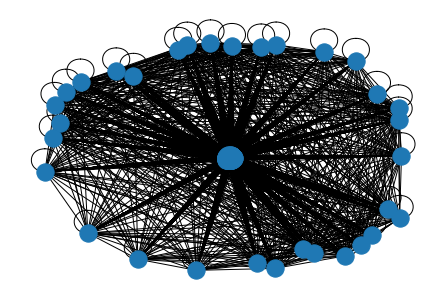

In [18]:
g = nx.from_numpy_array(pearson_adj_ca[3])
nx.draw(g)

<matplotlib.image.AxesImage object at 0x7fad2fc26a90>

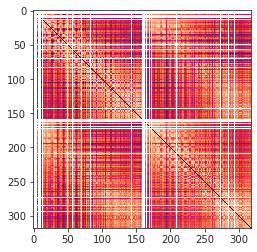

In [19]:
plt.imshow(nx.adjacency_matrix(g).toarray())

In [20]:
pearson_binary_ca = dc(pearson_adj_ca)
for i, a in enumerate(pearson_adj_ca):
    th = calculate_threshold(a, 0.1).item()
    pearson_binary_ca[i][pearson_binary_ca[i] <= th] = 0.
    pearson_binary_ca[i][pearson_binary_ca[i] > th] = 1

spearman_binary_ca = dc(spearman_adj_ca)
for i, a in enumerate(spearman_adj_ca):
    th = calculate_threshold(a, 0.1).item()
    spearman_binary_ca[i][spearman_binary_ca[i] <= th] = 0.
    spearman_binary_ca[i][spearman_binary_ca[i] > th] = 1

pearson_binary_ca.shape, spearman_binary_ca.shape

((252, 318, 318), (252, 318, 318))

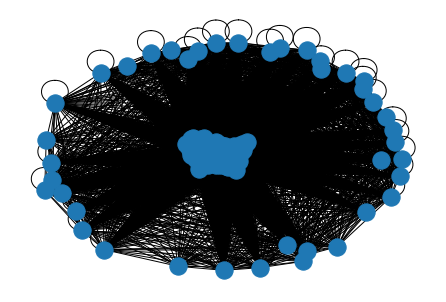

In [21]:
g = nx.from_numpy_array(pearson_binary_ca[3])
nx.draw(g)

<matplotlib.image.AxesImage object at 0x7fad04394a90>

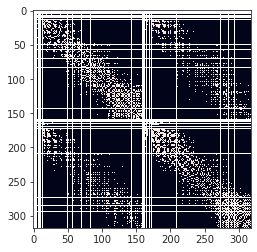

In [22]:
plt.imshow(nx.adjacency_matrix(g).toarray())

In [25]:
adj = nx.adjacency_matrix(g).toarray()
adj[np.isnan(adj)] = 0

In [26]:
adj.astype(bool).astype(int)

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 1, 0],
       [0, 0, 0, ..., 1, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]])

In [15]:
mako = sns.color_palette('mako', as_cmap=True)
rocket = sns.color_palette('rocket', as_cmap=True)
pal = {'ca2': mako(0.6), 'bold-lite': rocket(0.6)}

num_k, perc = 5, 10
props_base = {
    'perc': f'p{perc}-sample',
    'num_k': num_k,
    'mice': mice,
    'task': 'rest',
    'metric': 'pearson',
    'match_using': 'gam',
    'match_metric': 'euclidean',
    'graph_type': 'real',
    'verbose': False,
}
props_ca = {'mode': 'ca2', **props_base}
props_bold = {'mode': 'bold-lite', **props_base}

gr_ca = Group(**props_ca)

In [16]:
deg_pearson_ca = np.nansum(pearson_binary_ca, -1)
deg_spearman_ca = np.nansum(spearman_binary_ca, -1)

deg_pearson_ca[deg_pearson_ca == 0] = np.nan
deg_spearman_ca[deg_spearman_ca == 0] = np.nan

In [17]:
proj_led_ca = gr_ca.project_vec(bn.nanmean(deg_spearman_ca[led_run_ids], 0), add_disjoint=False)
proj_rest_ca = gr_ca.project_vec(bn.nanmean(deg_spearman_ca[rest_run_ids], 0), add_disjoint=False)
trc_led = gr_ca.trim2d(proj_led_ca)
trc_rest = gr_ca.trim2d(proj_rest_ca)

<matplotlib.colorbar.Colorbar object at 0x7fa4c5345ee0>

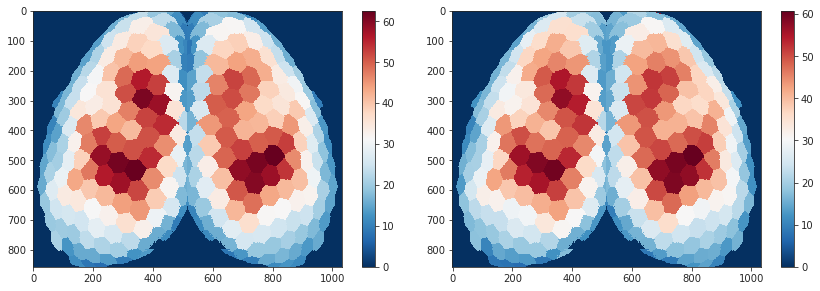

In [18]:
fig, axes = create_figure(1, 2, (12, 4))
im = axes[0].imshow(trc_rest['proj-top'][0], cmap='RdBu_r')
plt.colorbar(im, ax=axes[0])
im = axes[1].imshow(trc_led['proj-top'][0], cmap='RdBu_r')
plt.colorbar(im, ax=axes[1])

In [19]:
proj_led_ca = gr_ca.project_vec(bn.nanstd(deg_spearman_ca[led_run_ids], 0), add_disjoint=False)
proj_rest_ca = gr_ca.project_vec(bn.nanstd(deg_spearman_ca[rest_run_ids], 0), add_disjoint=False)
trc_led = gr_ca.trim2d(proj_led_ca)
trc_rest = gr_ca.trim2d(proj_rest_ca)

In [22]:
deg_spearman_ca = np.nansum(spearman_adj_ca, -1)
proj_led_ca = gr_ca.project_vec(bn.nanstd(deg_spearman_ca[led_run_ids], 0), add_disjoint=False)
proj_rest_ca = gr_ca.project_vec(bn.nanstd(deg_spearman_ca[rest_run_ids], 0), add_disjoint=False)
trc_led = gr_ca.trim2d(proj_led_ca)
trc_rest = gr_ca.trim2d(proj_rest_ca)

<matplotlib.colorbar.Colorbar object at 0x7fa4c5f189d0>

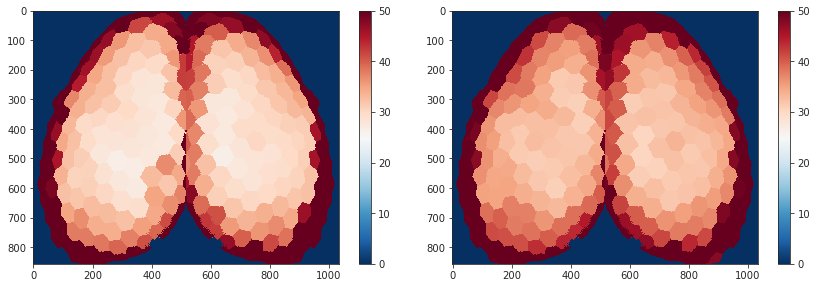

In [29]:
vamx = 50

fig, axes = create_figure(1, 2, (12, 4))
im = axes[0].imshow(trc_rest['proj-top'][0], cmap='RdBu_r', vmax=vamx)
plt.colorbar(im, ax=axes[0])
im = axes[1].imshow(trc_led['proj-top'][0], cmap='RdBu_r', vmax=vamx)
plt.colorbar(im, ax=axes[1])

<matplotlib.colorbar.Colorbar object at 0x7f5a937b6f70>

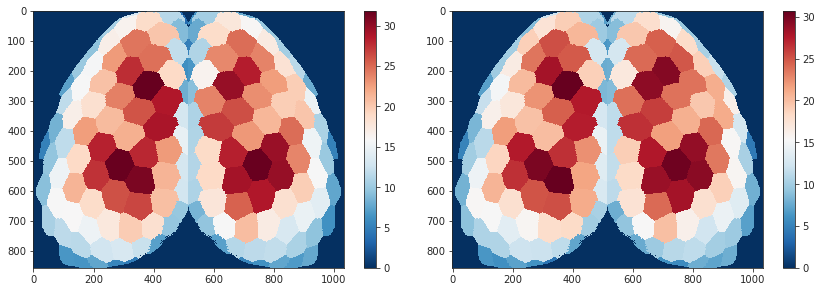

<matplotlib.colorbar.Colorbar object at 0x7f5931f84280>

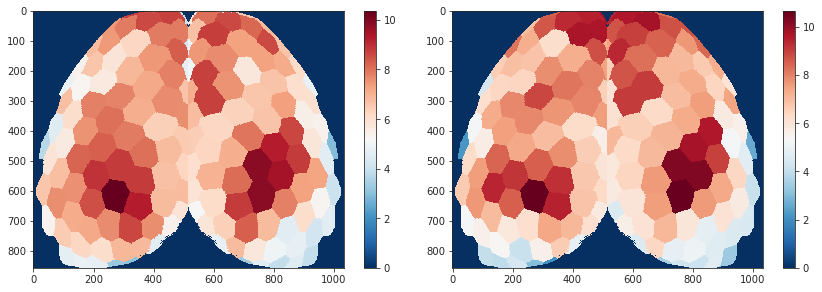

<matplotlib.colorbar.Colorbar object at 0x7f5aa64cb2e0>

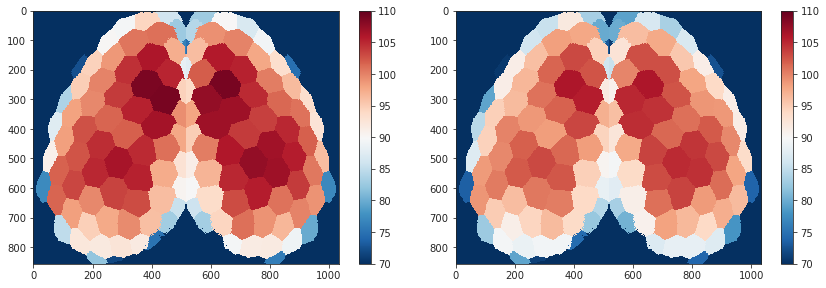

In [493]:
vmin = 70
vmax = 110

fig, axes = create_figure(1, 2, (12, 4))
im = axes[0].imshow(trc_rest['proj-top'][0], cmap='RdBu_r', vmin=vmin, vmax=vmax)
plt.colorbar(im, ax=axes[0])
im = axes[1].imshow(trc_led['proj-top'][0], cmap='RdBu_r', vmin=vmin, vmax=vmax)
plt.colorbar(im, ax=axes[1])

In [420]:
%%time

pearson_proj_ca = gr_ca.project_vec(deg_pearson_ca[valid_run_ids], add_disjoint=False)
spearman_proj_ca = gr_ca.project_vec(deg_spearman_ca[valid_run_ids], add_disjoint=False)

CPU times: user 15.4 s, sys: 5.88 s, total: 21.3 s
Wall time: 21.3 s


In [421]:
%%time

trc_pear = gr_ca.trim2d(pearson_proj_ca)
trc_spear = gr_ca.trim2d(spearman_proj_ca)

CPU times: user 12.1 s, sys: 37.5 s, total: 49.6 s
Wall time: 50.5 s


In [426]:
ncols = 13
nrows = int(np.ceil(len(trc_pear['proj-top']) / ncols))
nrows, ncols * nrows

(16, 208)

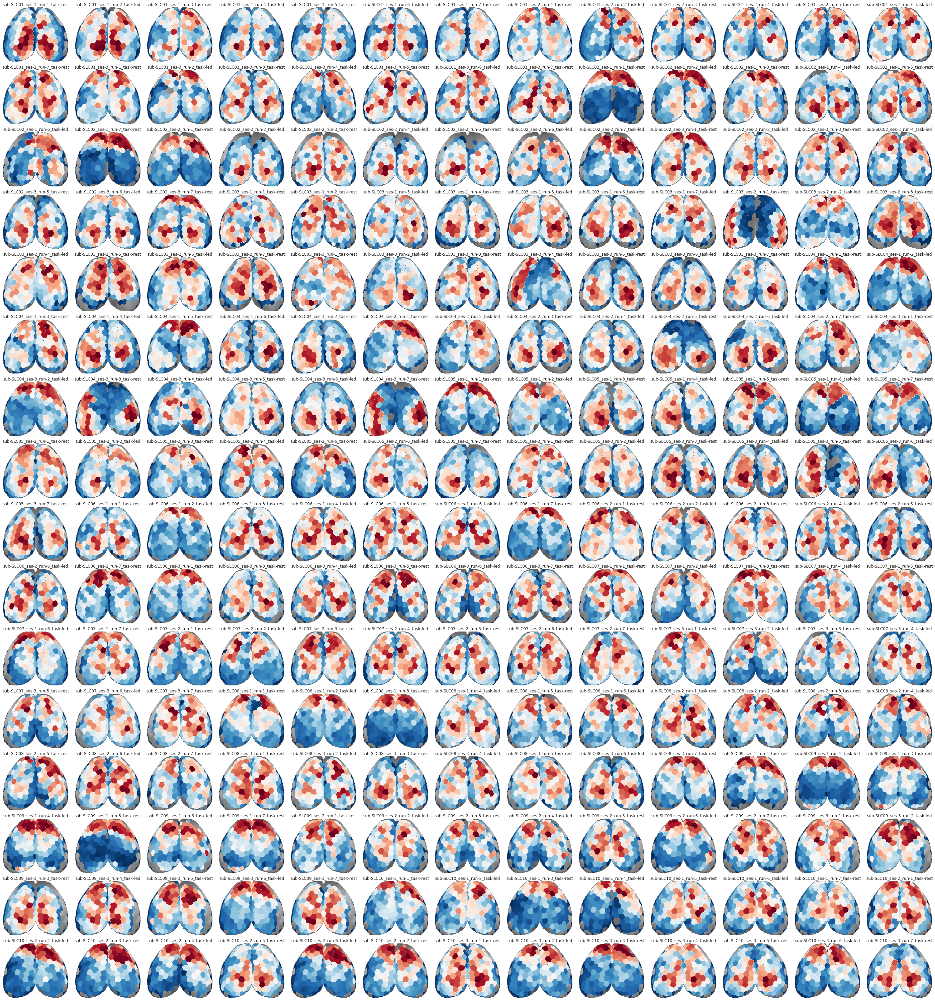

In [429]:
fig, axes = create_figure(nrows, ncols, (39, 2.6 * nrows))

for i, ax in enumerate(axes.flat):
    if i >= len(trc_pear['proj-top']):
        continue
    x2p = mwh(trc_pear['top'] == 0, trc['top'])
    ax.imshow(x2p, cmap='Greys_r')
    
    x2p = trc_pear['proj-top'][i].copy()
    vmin = np.nanmin(x2p[x2p.nonzero()])
    vmax = np.nanmax(x2p[x2p.nonzero()])
    x2p = gaussian_filter(x2p, 1)
    x2p = mwh(trc_pear['top'] == 0, x2p)
    ax.imshow(x2p, cmap='RdBu_r', interpolation='antialiased', vmin=vmin, vmax=vmax)
    ax.set_title(list(pearson)[valid_run_ids[i]], fontsize=12)

remove_ticks(axes)
trim_axs(axes, len(trc_pear['proj-top']))
plt.show()

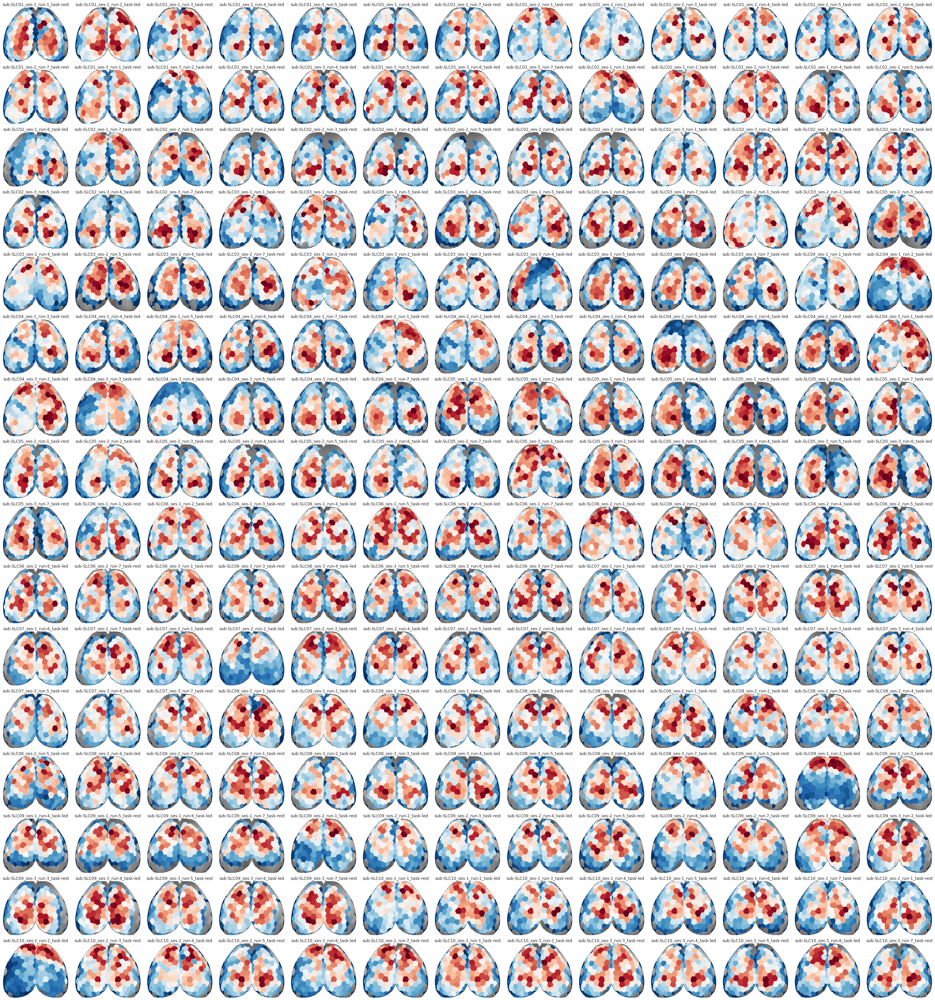

In [430]:
fig, axes = create_figure(nrows, ncols, (39, 2.6 * nrows))

for i, ax in enumerate(axes.flat):
    if i >= len(trc_spear['proj-top']):
        continue
    x2p = mwh(trc_spear['top'] == 0, trc['top'])
    ax.imshow(x2p, cmap='Greys_r')
    
    x2p = trc_spear['proj-top'][i].copy()
    vmin = np.nanmin(x2p[x2p.nonzero()])
    vmax = np.nanmax(x2p[x2p.nonzero()])
    x2p = gaussian_filter(x2p, 1)
    x2p = mwh(trc_spear['top'] == 0, x2p)
    ax.imshow(x2p, cmap='RdBu_r', interpolation='antialiased', vmin=vmin, vmax=vmax)
    ax.set_title(list(spearman)[valid_run_ids[i]], fontsize=12)

remove_ticks(axes)
trim_axs(axes, len(trc_spear['proj-top']))
plt.show()

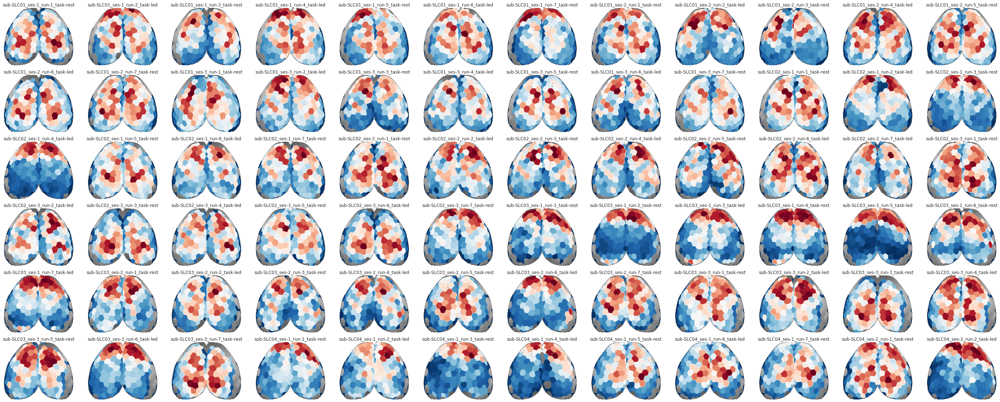

In [412]:
fig, axes = create_figure(nrows, ncols, (39, 2.6 * nrows))

for i, ax in enumerate(axes.flat):
    if i >= len(trc_pear['proj-top']):
        continue
    x2p = mwh(trc_pear['top'] == 0, trc['top'])
    ax.imshow(x2p, cmap='Greys_r')
    
    x2p = trc_pear['proj-top'][i].copy()
    vmin = np.nanmin(x2p[x2p.nonzero()])
    vmax = np.nanmax(x2p[x2p.nonzero()])
    x2p = gaussian_filter(x2p, 1)
    x2p = mwh(trc_pear['top'] == 0, x2p)
    ax.imshow(x2p, cmap='RdBu_r', interpolation='antialiased', vmin=vmin, vmax=vmax)
    ax.set_title(list(pearson)[valid_run_ids[i]], fontsize=12)

remove_ticks(axes)
trim_axs(axes, len(trc['proj-top']))
plt.show()

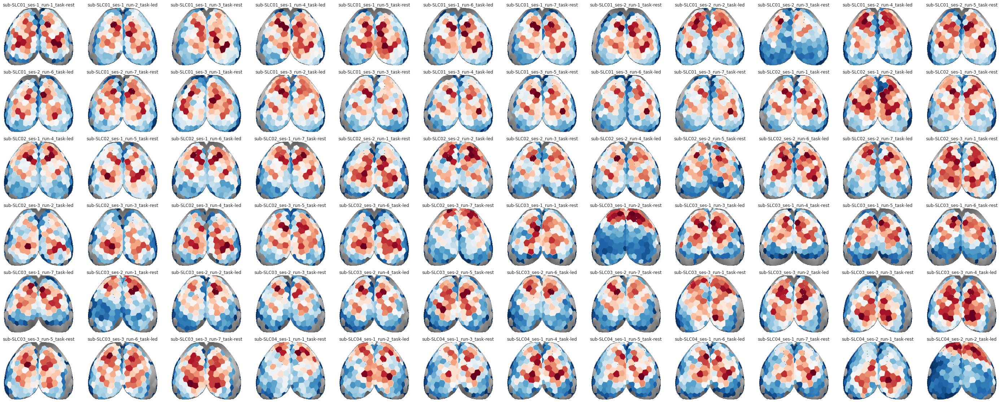

In [415]:
fig, axes = create_figure(nrows, ncols, (39, 2.6 * nrows))

for i, ax in enumerate(axes.flat):
    if i >= len(trc['proj-top']):
        continue
    x2p = mwh(trc['top'] == 0, trc['top'])
    ax.imshow(x2p, cmap='Greys_r')
    
    x2p = trc['proj-top'][i].copy()
    vmin = np.nanmin(x2p[x2p.nonzero()])
    vmax = np.nanmax(x2p[x2p.nonzero()])
    x2p = gaussian_filter(x2p, 1)
    x2p = mwh(trc['top'] == 0, x2p)
    ax.imshow(x2p, cmap='RdBu_r', interpolation='antialiased', vmin=vmin, vmax=vmax)
    ax.set_title(list(pearson)[valid_run_ids[i]], fontsize=12)

remove_ticks(axes)
trim_axs(axes, len(trc['proj-top']))
plt.show()

In [417]:
deg_spearman_ca[valid_run_ids]

(208, 174)

In [293]:
x = deg_pearson_ca[valid_run_ids][0].copy()

<AxesSubplot:ylabel='Count'>

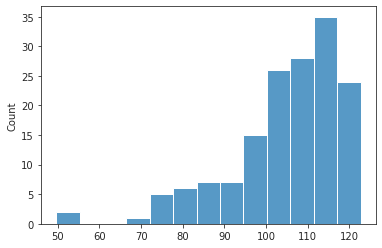

In [294]:
sns.histplot(x[x.nonzero()])

In [280]:
trc['proj-top']

array([[[0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        ...,
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.]],

       [[0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        ...,
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.]],

       [[0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        ...,
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.]],

       ...,

       [[0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        ...,
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.]],

       [[0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        ...,
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.]],

       [[0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        ...,
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.]]])

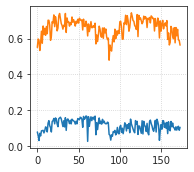

In [115]:
d_bold = res['a_bold'].mean(0)
d_ca = res['a_ca'].mean(0)

fig, ax = create_figure(figsize=(2.8, 2.5))
ax.plot(d_bold)
ax.plot(d_ca)
ax.grid()
plt.show()

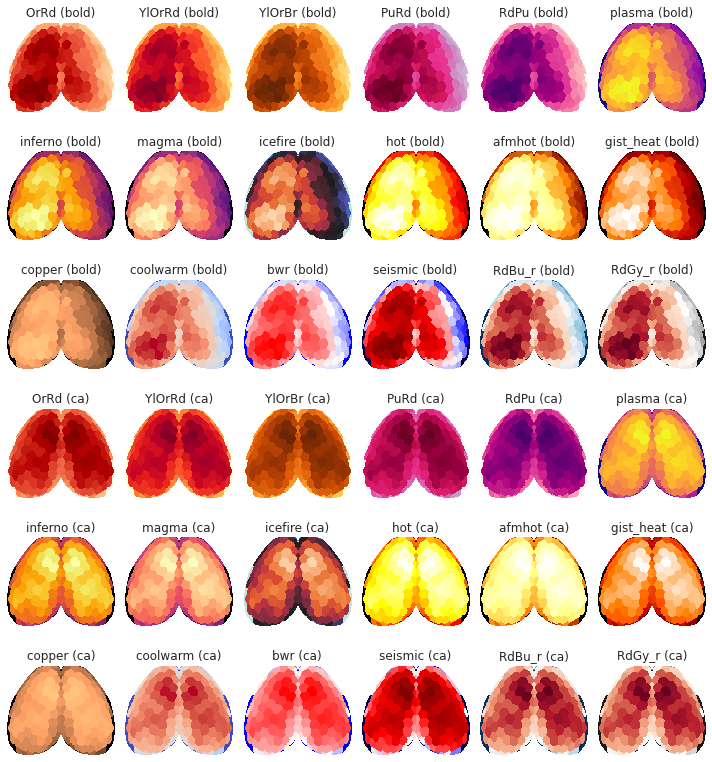

In [117]:
thres = -np.inf
dpb = gr_bold.project_vec(d_bold, thres=thres, add_disjoint=False)
dpc = gr_ca.project_vec(d_ca, thres=thres, add_disjoint=False)

trb = gr_bold.trim2d(dpb)
trc = gr_bold.trim2d(dpc)

fig, axes = create_figure(6, 6, (10, 11))

for cm, ax in zip(cm_candidates, axes[:3].flat):
    x2plt = np.ma.masked_where(trb['top'] == 0, trb['top'])
    ax.imshow(x2plt, cmap='Greys_r')
    x2plt = np.ma.masked_where(trb['top'] == 0, trb['proj-top'][0])
    ax.imshow(x2plt, cmap=cm, vmin=np.nanmin(d_bold), vmax=np.nanmax(d_bold))
    ax.set_title(f"{cm} (bold)")

for cm, ax in zip(cm_candidates, axes[3:].flat):
    x2plt = np.ma.masked_where(trc['top'] == 0, trc['top'])
    ax.imshow(x2plt, cmap='Greys_r')
    x2plt = np.ma.masked_where(trc['top'] == 0, trc['proj-top'][0])
    ax.imshow(x2plt, cmap=cm, vmin=np.nanmin(d_ca), vmax=np.nanmax(d_ca))
    ax.set_title(f"{cm} (ca)")
    
remove_ticks(axes)
plt.show()